In [56]:
import numpy as np
import pandas as pd

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
df = pd.read_csv('Churn_Modelling.csv', sep=',')
df.sample(n=10)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
1554,1555,15779481,Swadling,628,France,Male,34,4,158741.43,2,1,1,126192.54,0
9049,9050,15584288,Hung,629,France,Female,33,6,0.00,2,1,1,59129.72,0
6775,6776,15751455,Boyle,469,France,Female,48,5,0.00,1,1,0,160529.71,1
4069,4070,15656613,McGregor,646,France,Female,34,3,131283.11,1,0,0,130500.65,0
794,795,15776807,Brennan,654,France,Male,29,1,0.00,1,1,0,180345.44,0
2157,2158,15750649,Uwakwe,744,France,Female,44,3,0.00,2,1,1,189016.14,0
9867,9868,15620936,Warren,787,France,Male,32,4,0.00,2,1,1,13238.93,0
6387,6388,15810807,Alekseeva,513,France,Female,43,9,0.00,2,1,0,152499.80,0
5791,5792,15730044,Greco,809,Germany,Female,42,6,64497.94,3,0,1,182436.81,1
6499,6500,15702561,Dale,782,France,Male,32,9,0.00,1,1,1,87566.97,0


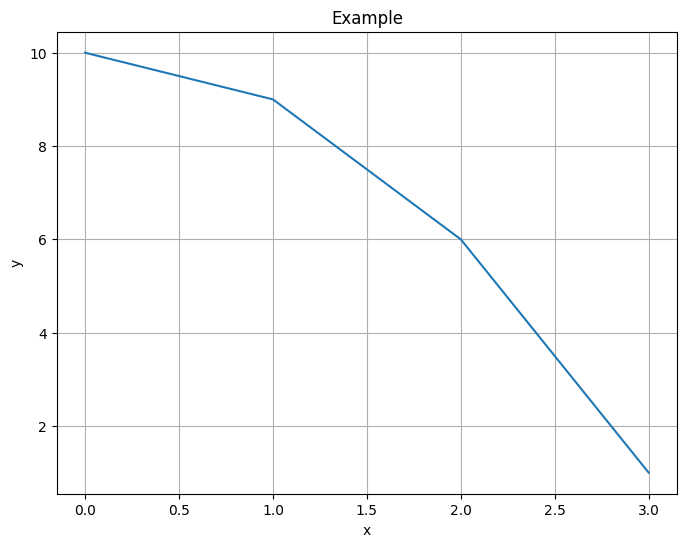

In [8]:
plt.figure(figsize=(8, 6))
plt.plot([0, 1, 2, 3], [10, 9, 6, 1])
plt.xlabel('x')
plt.ylabel('y')
plt.title('Example')
plt.grid();

In [9]:
data = df.groupby('Age')['Geography'].agg(count='count').reset_index().sort_values(by='Age')
data.head()

,Age,count
0,18,22
1,19,27
2,20,40
3,21,53
4,22,84


Text(0, 0.5, 'Кол-во клиентов')

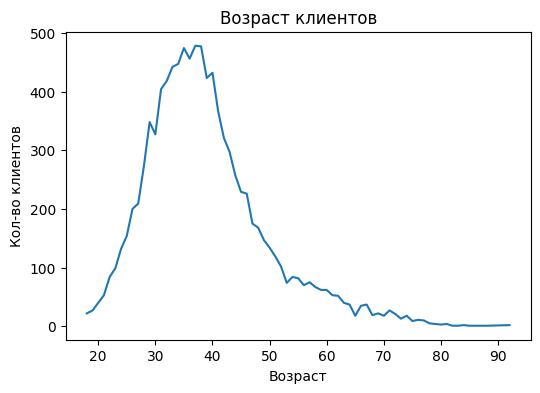

In [11]:
plt.figure(figsize=(6, 4))

plt.plot(data['Age'], data['count'])

plt.title('Возраст клиентов')
plt.xlabel('Возраст')
plt.ylabel('Кол-во клиентов')

Text(0, 0.5, 'Кол-во клиентов')

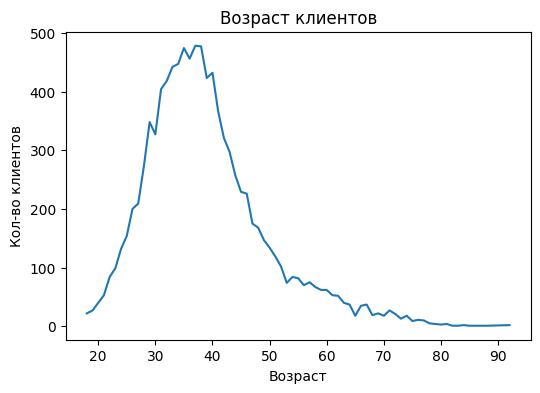

In [12]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data['Age'], y=data['count'])

plt.title('Возраст клиентов')
plt.xlabel('Возраст')
plt.ylabel('Кол-во клиентов')

Text(0, 0.5, 'Кол-во клиентов')

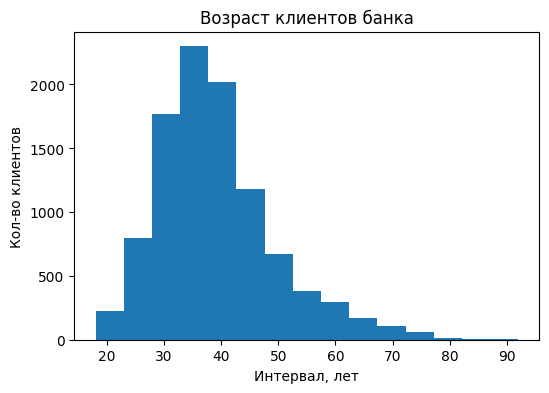

In [13]:
plt.figure(figsize=(6, 4))

plt.hist(df['Age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов')

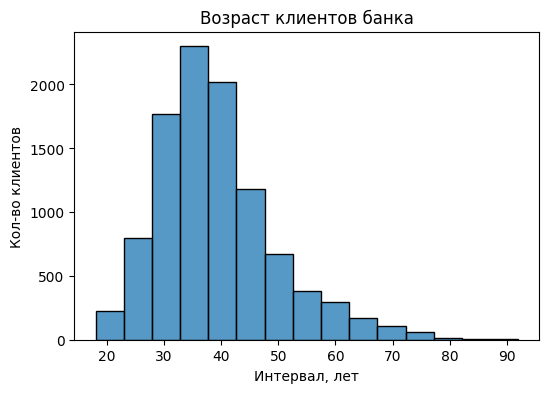

In [16]:
plt.figure(figsize=(6, 4))

sns.histplot(df['Age'], bins=15)

plt.title('Возраст клиентов банка')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

In [22]:
# Готовим данные для графика в виде сводной таблицы
data = df.groupby('Age')['NumOfProducts'].sum().reset_index()
data.head()

,Age,NumOfProducts
0,18,33
1,19,37
2,20,62
3,21,88
4,22,128


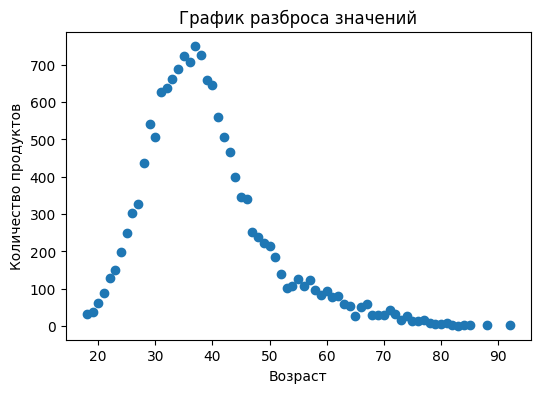

In [24]:
plt.figure(figsize=(6, 4))

plt.scatter(data['Age'], data['NumOfProducts'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Количество продуктов');

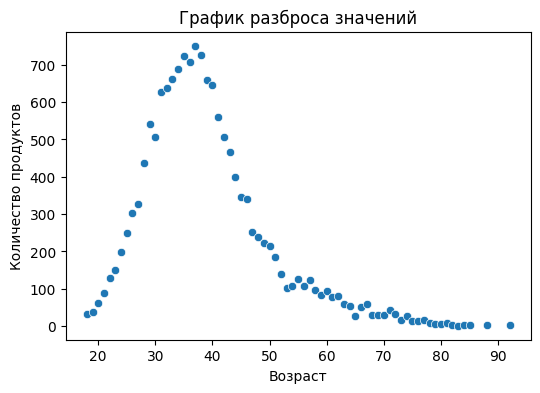

In [26]:
plt.figure(figsize=(6, 4))

sns.scatterplot(x=data['Age'], y=data['NumOfProducts'])

plt.title('График разброса значений')
plt.xlabel('Возраст')
plt.ylabel('Количество продуктов');

In [27]:
# Готовим данные для графика
data = df['Geography'].value_counts().reset_index()
data.head()

,Geography,count
0,France,5014
1,Germany,2509
2,Spain,2477


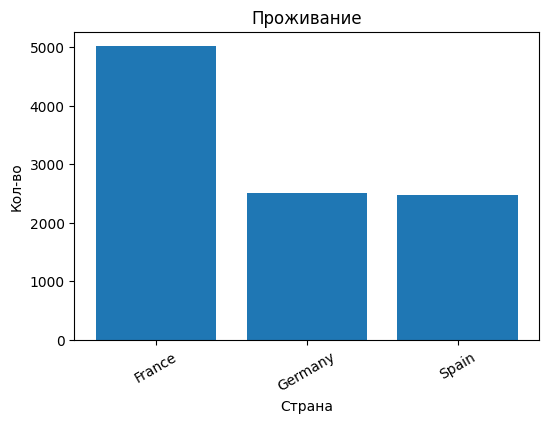

In [28]:
plt.figure(figsize=(6, 4))

plt.bar(data['Geography'], data['count'])

plt.title('Проживание')
plt.xlabel('Страна')
plt.ylabel('Кол-во')
plt.xticks(rotation=30);

In [31]:
# Готовим данные для графика
data = pd.crosstab(df['Tenure'], df['Exited']).reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

Exited,Tenure,no,yes
7,7,851,177
2,2,847,201
8,8,828,197
1,1,803,232
5,5,803,209


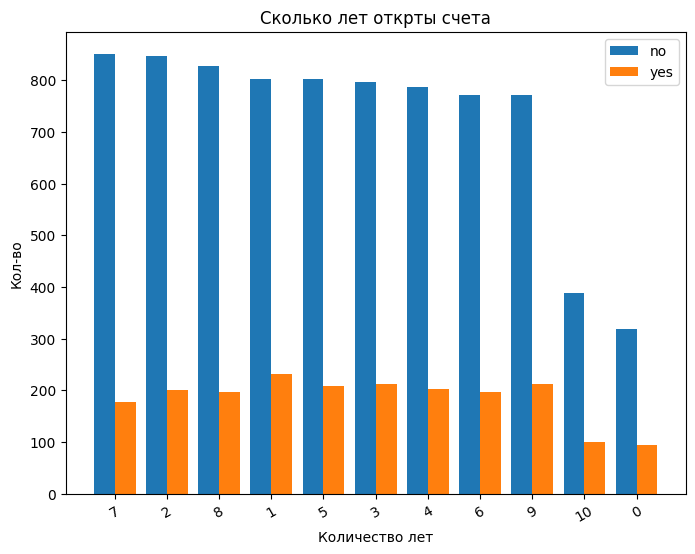

In [33]:
# Строим столбчатую многорядную диаграмму

plt.figure(figsize=(8, 6))

# определяем кол-во делений
n_ticks = np.arange(len(data['no']))

# определяем сдвиг
offset = 0.2

# определяем ширину столбцов
w = 0.4

# добавляем сдвиг к кол-ву делений
plt.bar(n_ticks - offset, data['no'], width=w)
plt.bar(n_ticks + offset, data['yes'], width=w)

plt.title('Сколько лет открты счета')
plt.xlabel('Количество лет')
plt.ylabel('Кол-во')
plt.legend(['no', 'yes'])
plt.xticks(n_ticks, data['Tenure'], rotation = 30);  # добавляем метки делений


In [34]:
# Готовим данные для графика
data = pd.crosstab(df['Tenure'], df['Exited'], normalize='index').reset_index().sort_values(by=0, ascending=False)
data.rename(columns={0: 'no', 1: 'yes'}, inplace=True)
data.head()

Exited,Tenure,no,yes
7,7,0.827821,0.172179
2,2,0.808206,0.191794
8,8,0.807805,0.192195
6,6,0.797311,0.202689
4,4,0.794742,0.205258


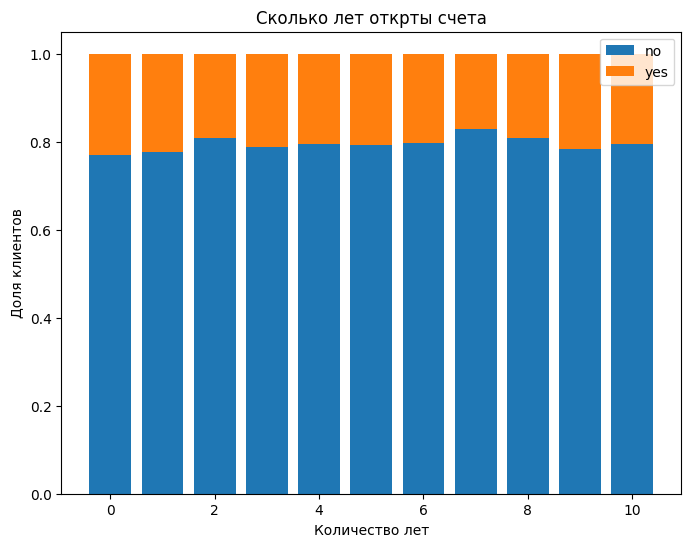

In [38]:
# Строим столбчатую многорядную сложенную диаграмму

plt.figure(figsize=(8, 6))

plt.bar(data['Tenure'], data['no'])
plt.bar(data['Tenure'], data['yes'], bottom=data['no'])

plt.title('Сколько лет открты счета')
plt.xlabel('Количество лет')
plt.ylabel('Доля клиентов')
plt.legend(['no', 'yes']);
# plt.xticks(rotation = 30);

In [40]:
df = pd.read_csv('housing.csv', sep=',')
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


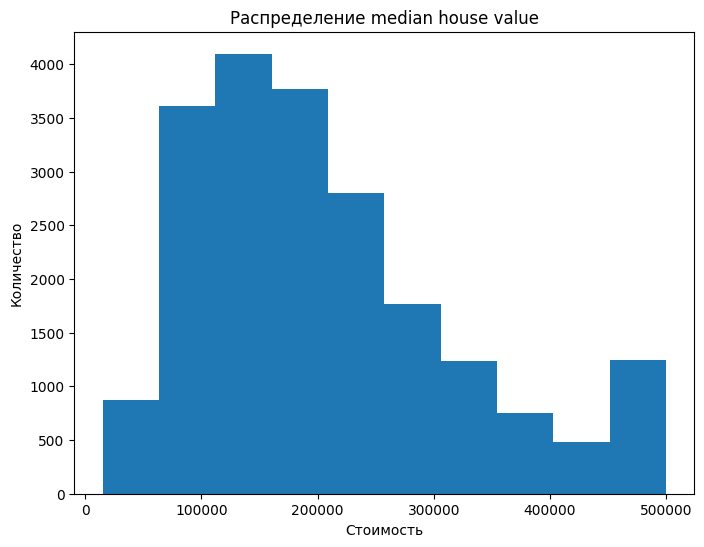

In [41]:
# {'red', 'green', 'blue'} - дискретный признак ('red', 'green', 'blue', 'red', 'green', 'red')
# [0, 100] - вещественный признак (0, 5, 5.6, 10.5, 10.57)
plt.figure(figsize=(8, 6))
plt.hist(df['median_house_value'])
plt.title('Распределение median house value')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

In [42]:
df_num_features = df.select_dtypes(include=['float64', 'float32', 'float16'])
df_num_features.drop('median_house_value', axis=1, inplace=True)

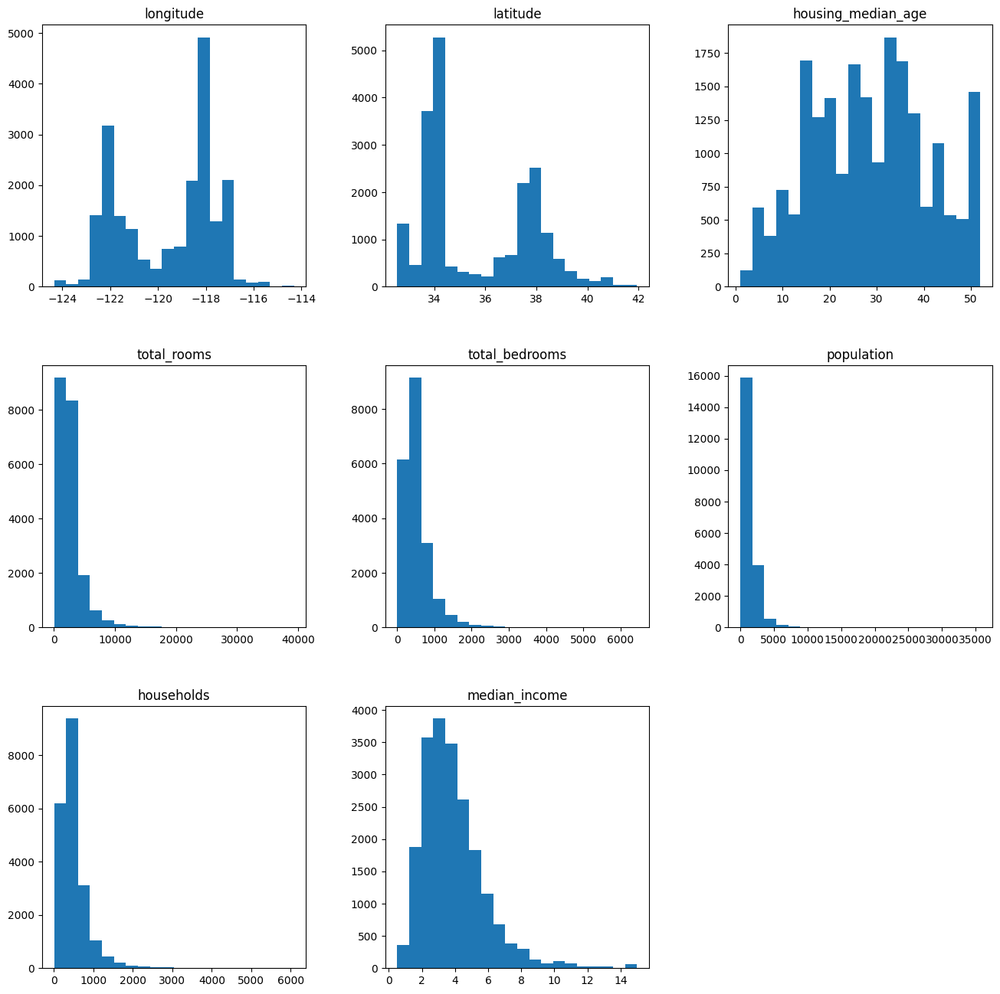

In [43]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

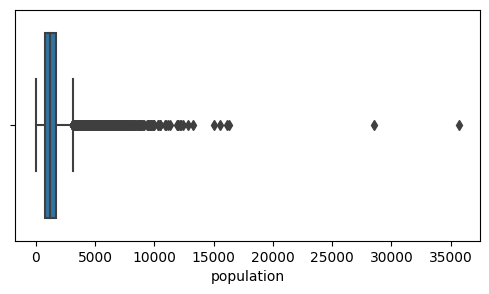

In [44]:
plt.figure(figsize=(6, 3))

sns.boxplot(x=df['population'], whis=1.5)

plt.xlabel('population')
plt.show()

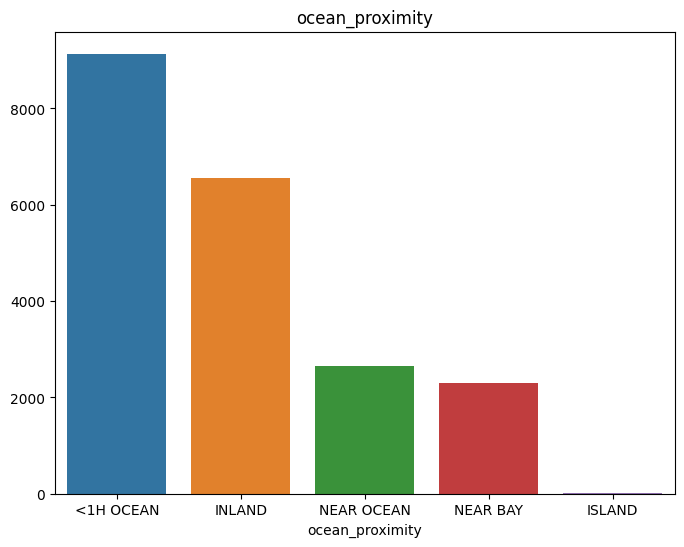

In [45]:
counts = df['ocean_proximity'].value_counts()
    
plt.figure(figsize=(8, 6))    
plt.title('ocean_proximity')
sns.barplot(x=counts.index, y=counts.values)
    
plt.show()

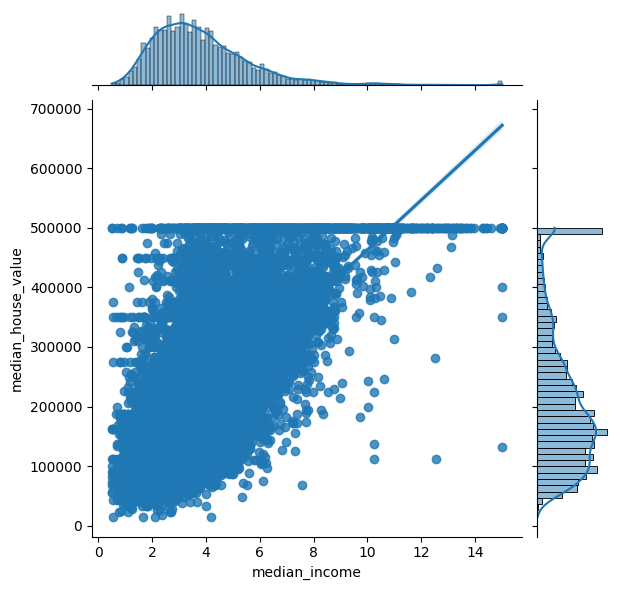

In [46]:
sns.jointplot(x=df['median_income'], y=df['median_house_value'], kind='reg');

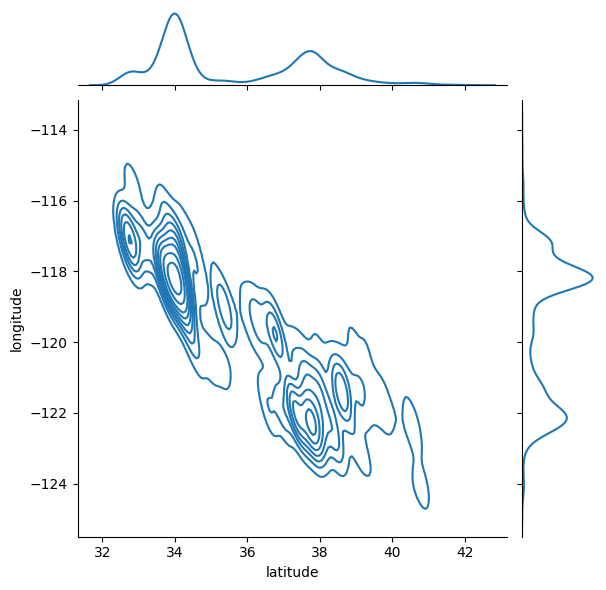

In [47]:
sns.jointplot(x=df['latitude'], y=df['longitude'], kind='kde');

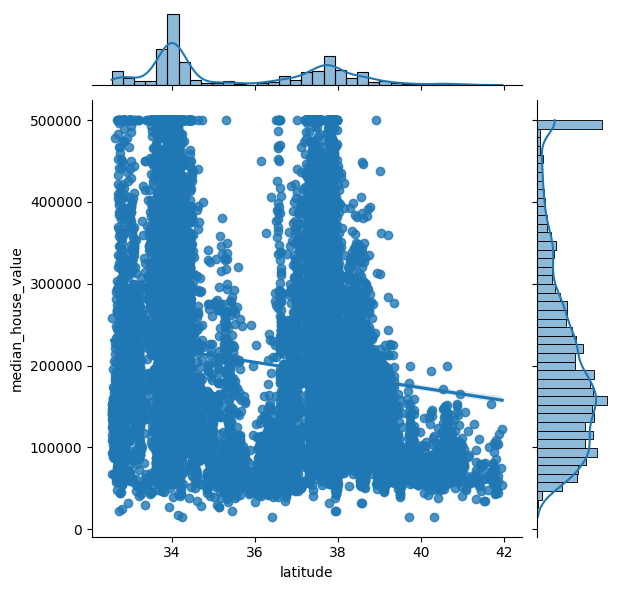

In [48]:
sns.jointplot(x=df['latitude'], y=df['median_house_value'], kind='reg');

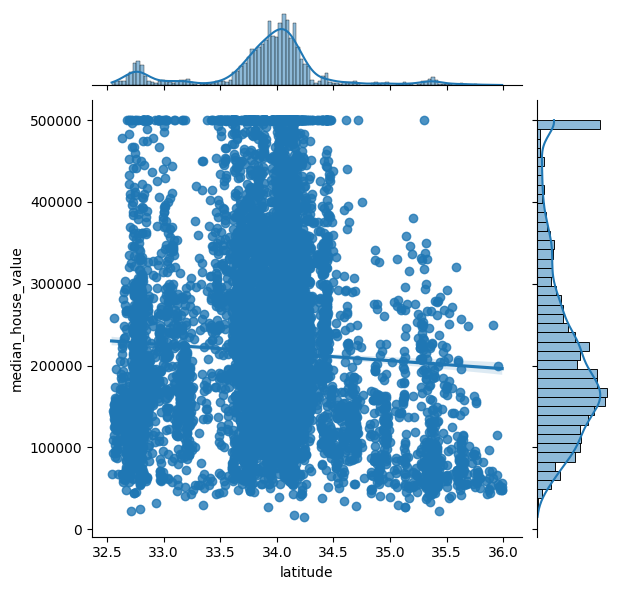

In [49]:
df_cut = df[df['latitude'] < 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

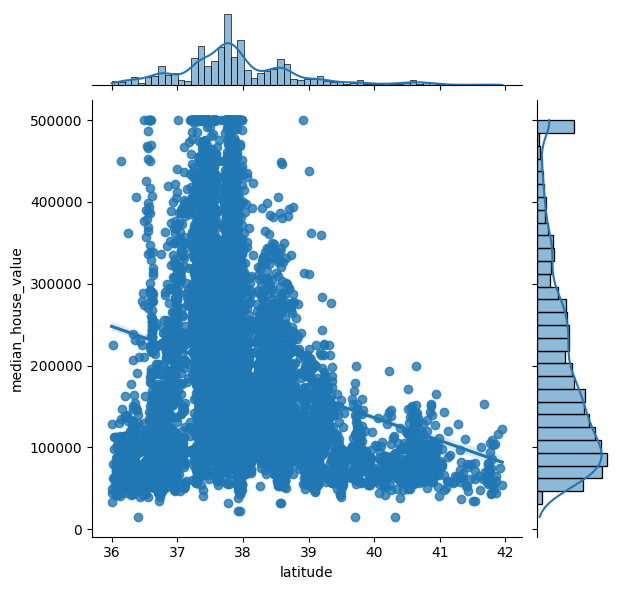

In [50]:
df_cut = df[df['latitude'] >= 36]
sns.jointplot(x=df_cut['latitude'], y=df_cut['median_house_value'], kind='reg');

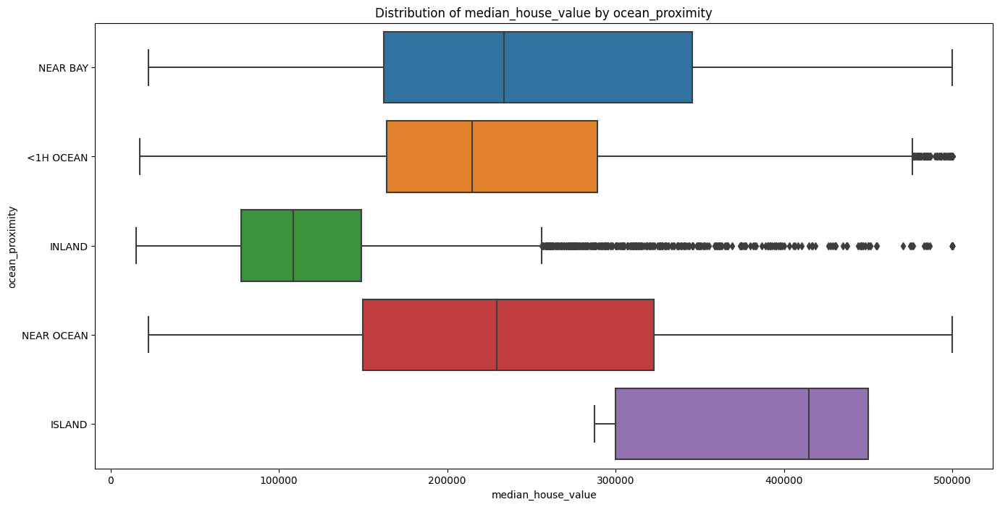

In [51]:
plt.figure(figsize=(16, 8))

sns.boxplot(x=df['median_house_value'], y=df['ocean_proximity'], whis=1.5)

plt.xlabel('median_house_value')
plt.ylabel('ocean_proximity')
plt.title('Distribution of median_house_value by ocean_proximity');

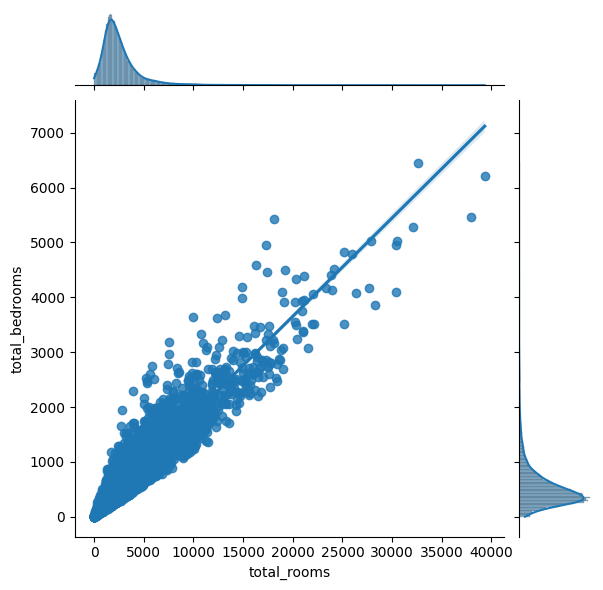

In [52]:
sns.jointplot(x=df['total_rooms'], y=df['total_bedrooms'], kind='reg');

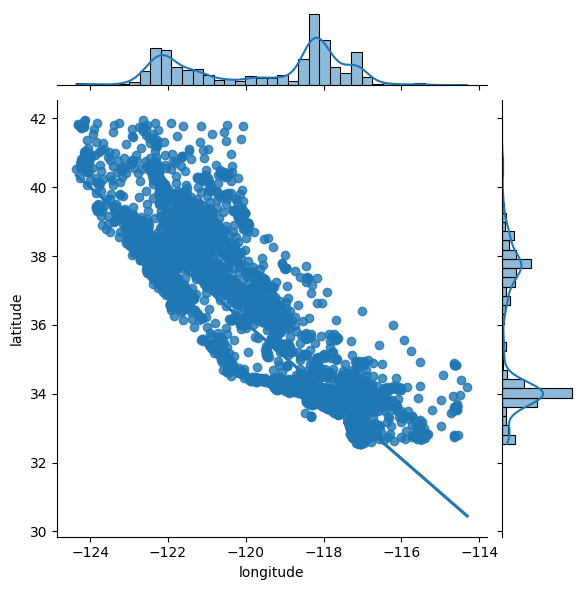

In [53]:

sns.jointplot(x=df['longitude'], y=df['latitude'], kind='reg');

In [66]:
df=df.drop(columns='ocean_proximity')

In [67]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
longitude,1.0,-0.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0
latitude,-0.9,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
housing_median_age,0.0,0.0,1.0,-0.4,-0.3,-0.3,-0.3,0.0,0.0
total_rooms,0.0,0.0,-0.4,1.0,0.9,0.9,0.9,0.0,0.0
total_bedrooms,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
population,0.0,0.0,-0.3,0.9,0.9,1.0,0.9,0.0,0.0
households,0.0,0.0,-0.3,0.9,1.0,0.9,1.0,0.0,0.0
median_income,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.7
median_house_value,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7,1.0


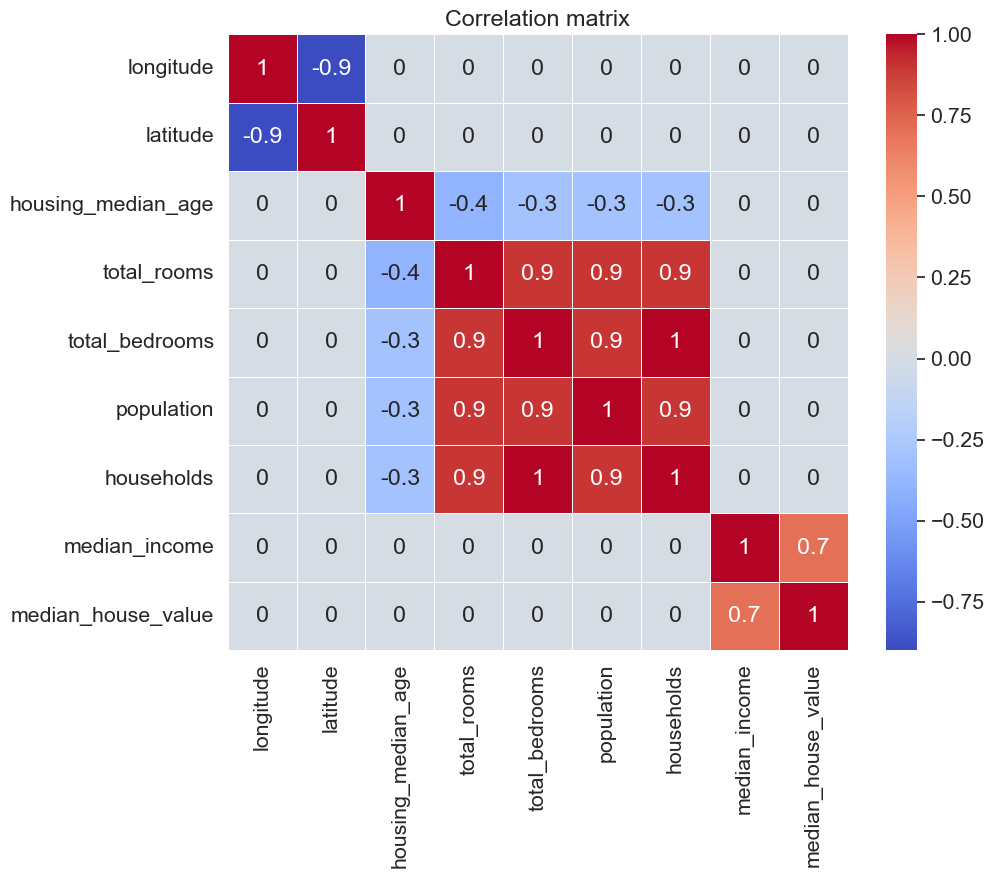

In [68]:
plt.figure(figsize=(10, 8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm')

plt.title('Correlation matrix');

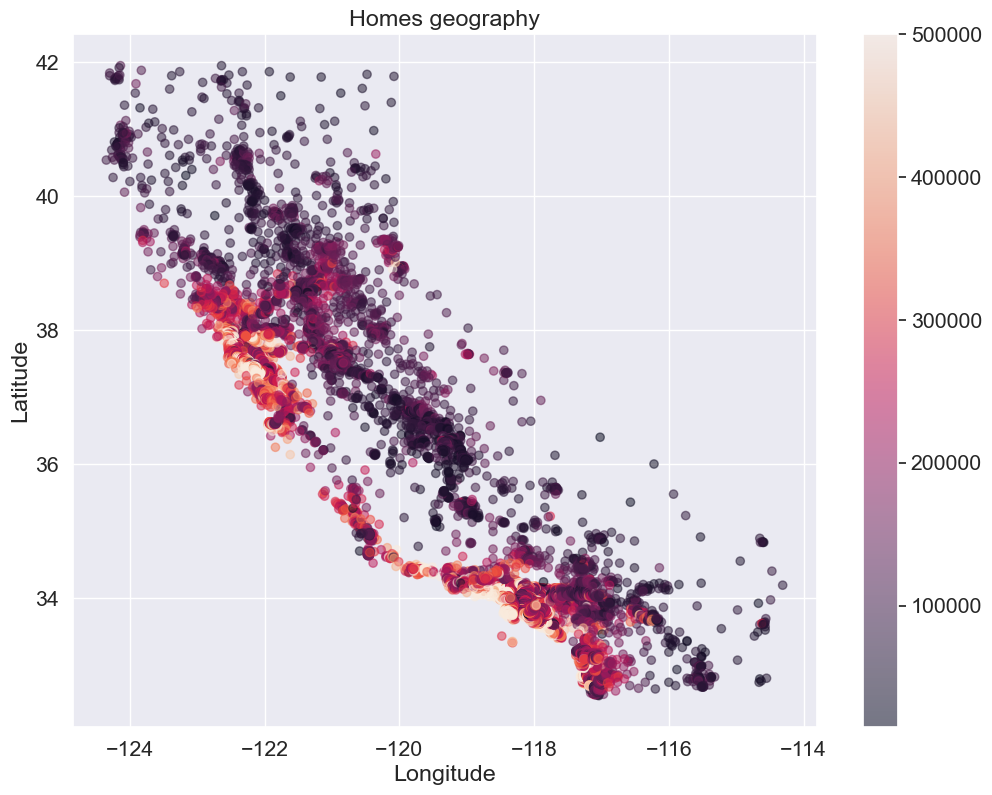

In [69]:
plt.figure(figsize=(12, 9))

sc = plt.scatter(df['longitude'], df['latitude'], alpha=0.5, c=df['median_house_value'])

# plt.imshow(california_map,
#            extent=[min_long, max_long, min_lat, max_lat], alpha=0.5)

plt.colorbar(sc)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Homes geography");

In [70]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.latitude, point.longitude],
        radius=2,
        popup=point.median_house_value
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

In [71]:
from keplergl import KeplerGl 

map_ = KeplerGl(height=700)
map_.add_data(df, 'Data')
map_.save_to_html(file_name='./california.html')

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md
Map saved to ./california.html!


C:\Users\akste\AppData\Roaming\Python\Python311\site-packages\jupyter_client\session.py:719: UserWarning: Message serialization failed with:
Out of range float values are not JSON compliant
Supporting this message is deprecated in jupyter-client 7, please make sure your message is JSON-compliant
  content = self.pack(content)
